In [1]:
import pathlib
import numpy as np
import scipy as sp
from matplotlib import pyplot as plt
import astropy as ast
from astropy import stats
import pandas as pd

import SessionTools.two_photon as st2p

plt.rcParams['pdf.fonttype']=42

%load_ext autoreload
%autoreload 2 


%matplotlib inline

In [2]:
basedir = pathlib.Path('/media/mplitt/SSD_storage/2P_scratch/ER4d_sytjGCaMP7f_R18B05LexA_CsChrimsontdT')
sess_df = pd.read_csv(basedir / 'sessions.csv')
sess_df['fly_id'] = [row['date']+'_'+row['fly'] for _, row in sess_df.iterrows()]


figfolder = pathlib.Path('/media/mplitt/SSD_storage/fig_scratch/LabMeetings/05_09_2024/ER4d_sytjGCaMP7f_R18B05LexA_CsChrimsontdT')
figfolder.mkdir(parents=True, exist_ok=True)

In [3]:
eg_folder = figfolder / 'exampled_sessions' 
eg_folder.mkdir(parents=True, exist_ok=True)

In [4]:
sess_mask = (sess_df['closed_loop']==1) & (sess_df['usable']==1) & (sess_df['remap']==0)
cl_sess_df = sess_df.loc[sess_mask]

In [28]:
def get_ts(pp, coef = .7):
    y_r4d = pp.timeseries['rois_z']
    heading = np.angle(np.exp(1j*(-1*pp.voltage_recording_aligned[' Heading'].to_numpy()-np.pi)))
    bar_vis_mask = (np.abs(heading)<2.14) * (pp.voltage_recording_aligned[' Arena DAC2']<7)
   
    # y_r4d-=1
    
    
    y_r4d_sm = sp.ndimage.gaussian_filter1d(sp.ndimage.gaussian_filter1d(y_r4d, .7, axis=1,mode='wrap'),2,axis=-1)
    

    y_r4d_norm = y_r4d_sm-y_r4d_sm.mean(axis=1,keepdims=True)

    
    n_rois = y_r4d.shape[1]
    x_f,y_f = st2p.utilities.pol2cart(y_r4d_sm[1,:,:] ,np.linspace(-np.pi,np.pi,num=n_rois)[:,np.newaxis])
    rho_r4d, phi_r4d = st2p.utilities.cart2pol(x_f.mean(axis=0), y_f.mean(axis=0))

    

    _,offset_r4d = st2p.utilities.cart2pol(*st2p.utilities.pol2cart(np.ones(heading.shape),phi_r4d-heading))
    
    
    return {'heading': heading,
            'bar_vis_mask': bar_vis_mask,
            'y_r4d': y_r4d,
    
            'y_r4d_sm': y_r4d_sm,
            'y_r4d_norm': y_r4d_norm,
    
            'rho_r4d': rho_r4d,
            'phi_r4d': phi_r4d,
            'offset_r4d': offset_r4d,
    }

def align_to_heading(ts):
    heading_bins = np.linspace(-np.pi, np.pi, num=17)
    heading_dig = np.digitize(ts['heading'], heading_bins)-1

    y_h_aligned = np.zeros_like(ts['y_r4d_sm'])
    for ind in range(ts['heading'].shape[0]):
        y_h_aligned[-1,:,ind] = np.roll(ts['y_r4d_sm'][1,:,ind], -heading_dig[ind])
        
    y_h_aligned_z = np.zeros((2,16,16))
    for b in range(16):
        mask = heading_dig==b
        y_h_aligned_z[:,:,b] = y_h_aligned[:,:,mask].mean(axis=-1)
    

    
    
    return heading_bins, y_h_aligned, y_h_aligned_z

   

/media/mplitt/SSD_storage/2P_scratch/ER4d_sytjGCaMP7f_R18B05LexA_CsChrimsontdT/30_08_2024/fly1/baseline-000/preprocess.pkl


/tmp/ipykernel_695756/2448773354.py:47: RuntimeWarning: Mean of empty slice.
  y_h_aligned_z[:,:,b] = y_h_aligned[:,:,mask].mean(axis=-1)
/home/mplitt/mambaforge/envs/SessionTools/lib/python3.10/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(


/media/mplitt/SSD_storage/2P_scratch/ER4d_sytjGCaMP7f_R18B05LexA_CsChrimsontdT/30_08_2024/fly1/post_180deg-002/preprocess.pkl
/media/mplitt/SSD_storage/2P_scratch/ER4d_sytjGCaMP7f_R18B05LexA_CsChrimsontdT/30_08_2024/fly2/baseline-000/preprocess.pkl
/media/mplitt/SSD_storage/2P_scratch/ER4d_sytjGCaMP7f_R18B05LexA_CsChrimsontdT/30_08_2024/fly2/post_0deg-002/preprocess.pkl
/media/mplitt/SSD_storage/2P_scratch/ER4d_sytjGCaMP7f_R18B05LexA_CsChrimsontdT/04_09_2024/fly3/post_0deg-003/preprocess.pkl
/media/mplitt/SSD_storage/2P_scratch/ER4d_sytjGCaMP7f_R18B05LexA_CsChrimsontdT/04_09_2024/fly3/post_180deg-005/preprocess.pkl
/media/mplitt/SSD_storage/2P_scratch/ER4d_sytjGCaMP7f_R18B05LexA_CsChrimsontdT/05_09_2024/fly1/baseline-000/preprocess.pkl
/media/mplitt/SSD_storage/2P_scratch/ER4d_sytjGCaMP7f_R18B05LexA_CsChrimsontdT/05_09_2024/fly1/post_0deg-003/preprocess.pkl
/media/mplitt/SSD_storage/2P_scratch/ER4d_sytjGCaMP7f_R18B05LexA_CsChrimsontdT/05_09_2024/fly1/post_180deg-005/preprocess.pkl
/med

/tmp/ipykernel_695756/2220443972.py:24: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax= plt.subplots(3,1, figsize=[15,9], sharex=True)


/media/mplitt/SSD_storage/2P_scratch/ER4d_sytjGCaMP7f_R18B05LexA_CsChrimsontdT/05_09_2024/fly2/post_0deg-004/preprocess.pkl
/media/mplitt/SSD_storage/2P_scratch/ER4d_sytjGCaMP7f_R18B05LexA_CsChrimsontdT/05_09_2024/fly3/baseline-000/preprocess.pkl
/media/mplitt/SSD_storage/2P_scratch/ER4d_sytjGCaMP7f_R18B05LexA_CsChrimsontdT/05_09_2024/fly3/post_0deg-002/preprocess.pkl
/media/mplitt/SSD_storage/2P_scratch/ER4d_sytjGCaMP7f_R18B05LexA_CsChrimsontdT/05_09_2024/fly3/post_180deg-004/preprocess.pkl
/media/mplitt/SSD_storage/2P_scratch/ER4d_sytjGCaMP7f_R18B05LexA_CsChrimsontdT/05_09_2024/fly4/baseline-001/preprocess.pkl
/media/mplitt/SSD_storage/2P_scratch/ER4d_sytjGCaMP7f_R18B05LexA_CsChrimsontdT/05_09_2024/fly4/post_180deg-004/preprocess.pkl
/media/mplitt/SSD_storage/2P_scratch/ER4d_sytjGCaMP7f_R18B05LexA_CsChrimsontdT/05_09_2024/fly4/post_0deg-006/preprocess.pkl
/media/mplitt/SSD_storage/2P_scratch/ER4d_sytjGCaMP7f_R18B05LexA_CsChrimsontdT/09_09_2024/fly1/baseline-000/preprocess.pkl
/media/

/tmp/ipykernel_695756/2448773354.py:47: RuntimeWarning: Mean of empty slice.
  y_h_aligned_z[:,:,b] = y_h_aligned[:,:,mask].mean(axis=-1)
/home/mplitt/mambaforge/envs/SessionTools/lib/python3.10/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(


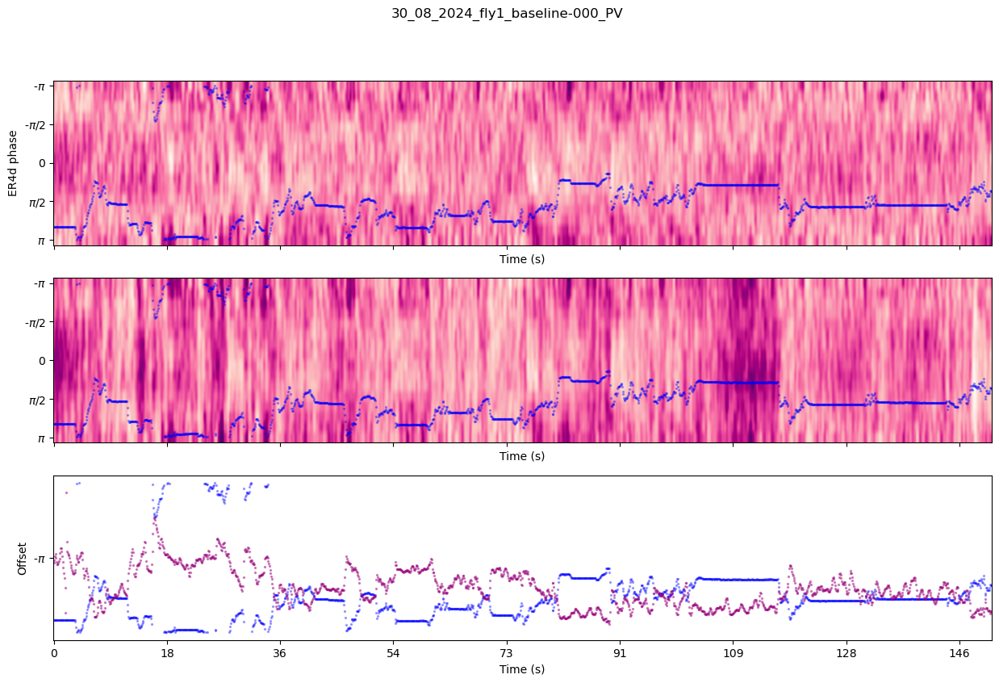

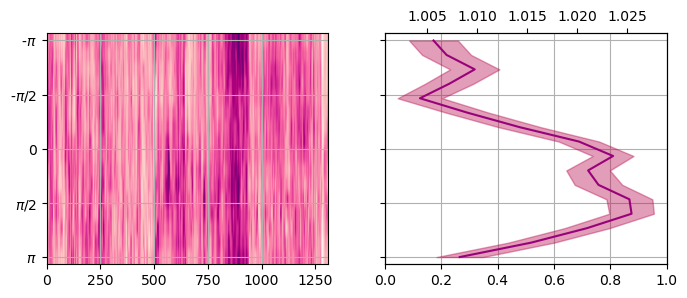

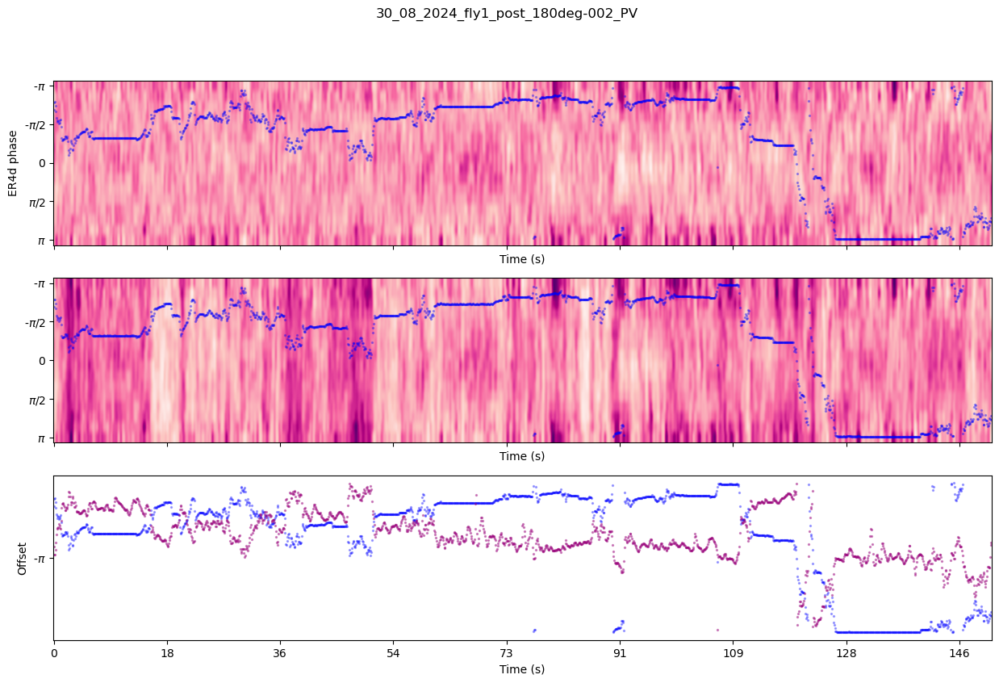

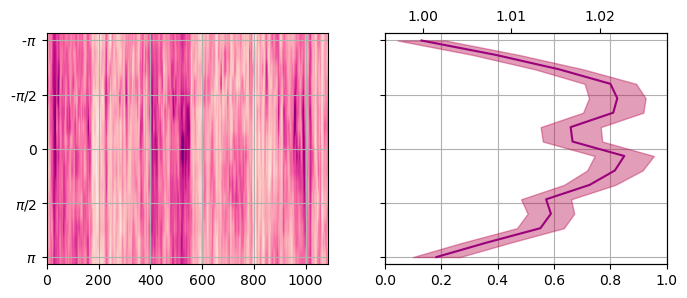

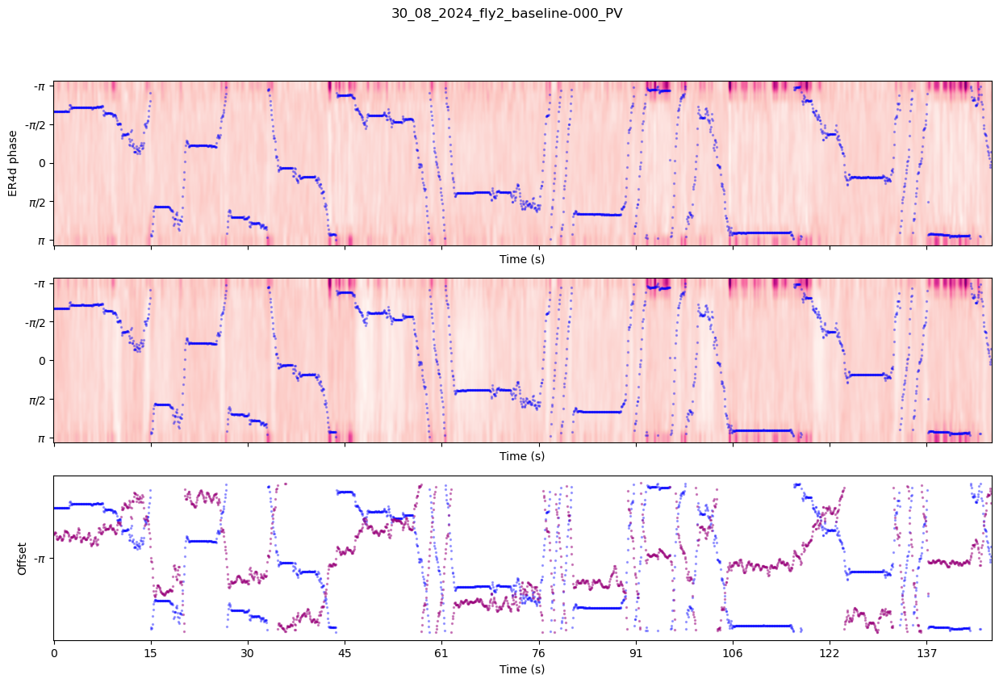

...

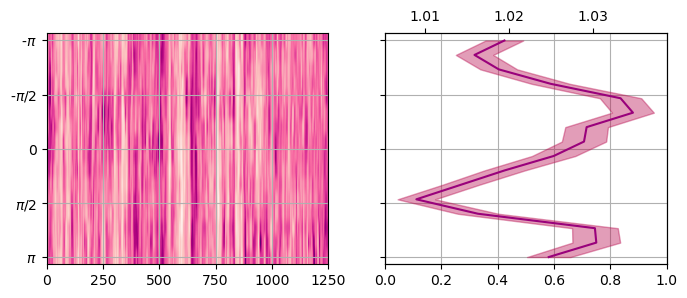

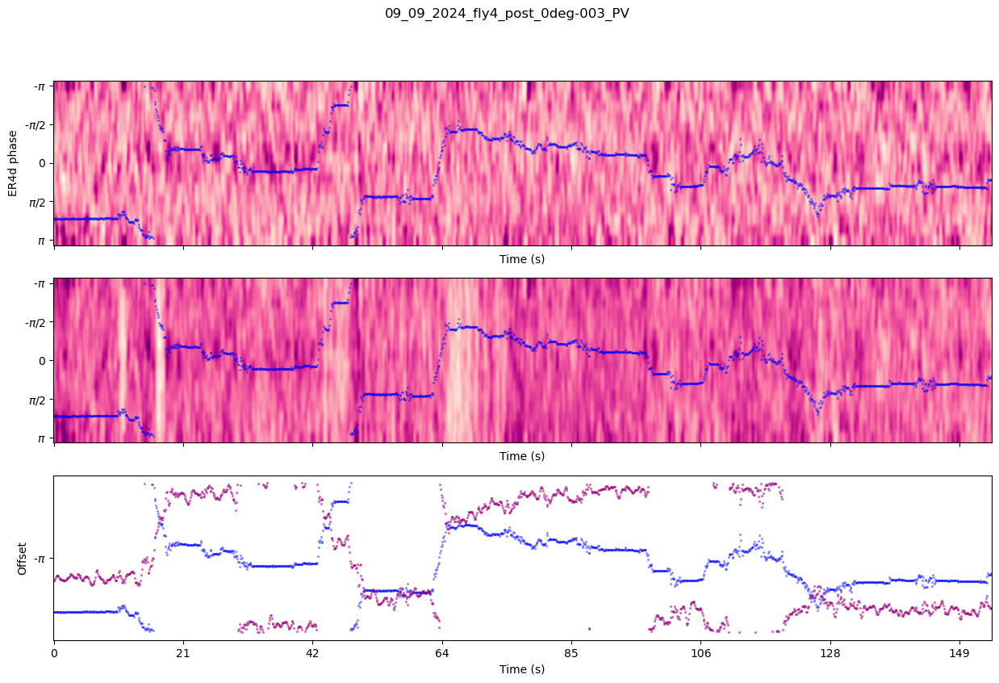

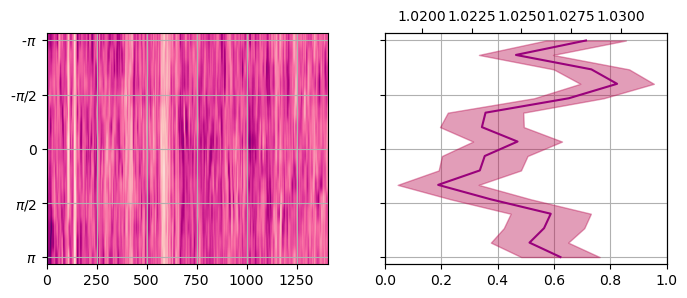

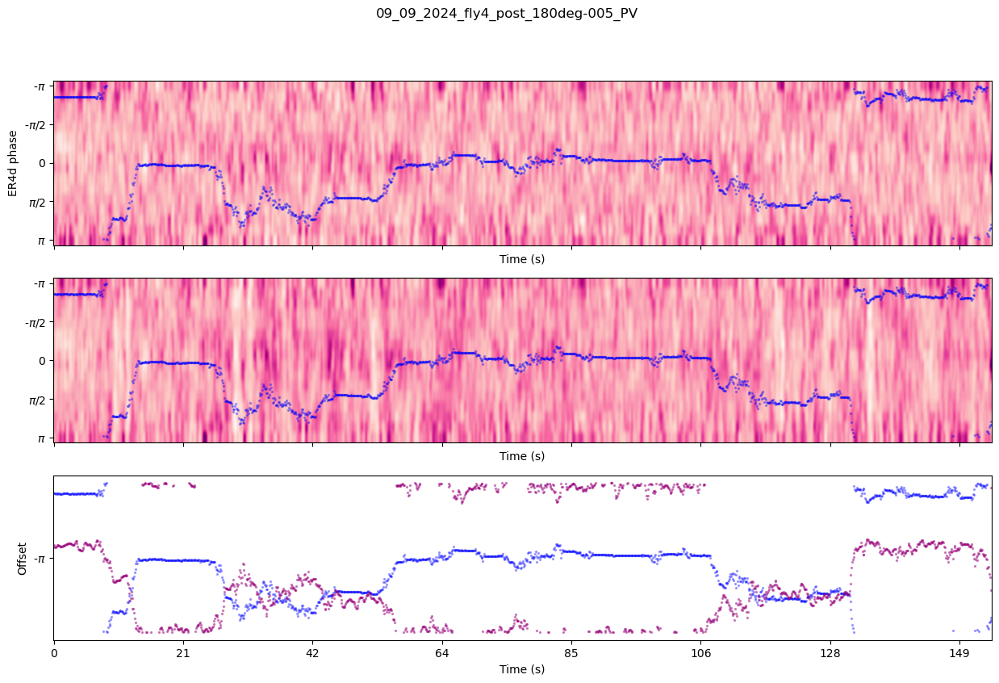

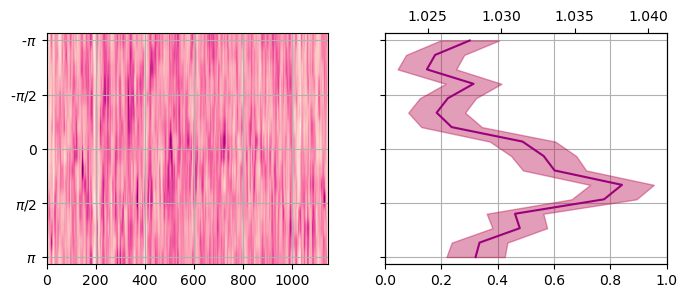

In [53]:

r4d_all, r4d_all_b, r4d_all_sem = [], [], []
offset_all = []
flies = []
for _, row in cl_sess_df.iterrows():
    
    outdir = pathlib.PurePath( basedir / row['date'] / row['fly'] / row['sess'] / 'preprocess.pkl')
        
    flies.append(row['fly_id'])
    pp = st2p.preprocessing.EBImagingSession.from_file(outdir)
    print(outdir)
    
    y_r4d = pp.calculate_zscored_F('rois', exp_detrend=True,zscore=False, reg_other_channel=False)
    # y_r4d -= y_r4d.mean(axis=1,keepdims=True)
   
    dt = pp.metadata['frame_period']*pp.metadata['layout']['frames_per_sequence']
    ts = get_ts(pp, coef=.0)

    heading_bins, y_h_aligned, y_h_aligned_z = align_to_heading(ts)
    mask = (np.abs(ts['heading'])<2.5)&(pp.voltage_recording_aligned[' Y/Index']<2)
    index_mask = 1.*(pp.voltage_recording_aligned[' Y/Index']<2)
    index_mask[index_mask==0]=np.nan


    fig, ax= plt.subplots(3,1, figsize=[15,9], sharex=True)


    alpha = ts['y_r4d_sm'][1,::-1,:]
    alpha = (alpha - np.amin(alpha))/(np.amax(alpha)-np.amin(alpha))
    alpha[alpha<.2]=0
    # hh = ax[0].imshow(ts['y_r4d_sm'][1,::-1,:], aspect='auto', cmap= 'RdPu', alpha = alpha)
    hh = ax[0].imshow(ts['y_r4d_norm'][1,::-1,:], aspect='auto', cmap= 'RdPu')#, vmin=-.4,vmax=.4)



    ax[1].imshow(ts['y_r4d_sm'][1,::-1,:], aspect='auto', cmap= 'RdPu')#, vmin=-.1, vmax=.7)
    
    ax[0].set_ylabel('ER4d/EPG phase')
    
    ax[0].set_ylabel('ER4d phase')


    for a in range(3):
        ax[a].set_yticks([r/2/np.pi*15 for r in (0,  np.pi/2,  np.pi,  6*np.pi/4,  2*np.pi)], 
                                                 labels = [r'-$\pi$',  r'-$\pi$/2',  '0',  r'$\pi$/2',  r'$\pi$'])


    t = np.arange(0,dt*y_h_aligned.shape[-1], dt)
    for a in range(3):
        ax[a].set_xticks(np.arange(t.shape[0])[::200], labels=[int(_t) for _t in  t[::200]])
        ax[a].set_xlabel('Time (s)')



    x = np.arange(ts['y_r4d'].shape[-1])
    heading_ = 15-15*(ts['heading']+np.pi)/2/np.pi
    ax[0].scatter(x, heading_*index_mask, alpha=.3, s=2, color='blue')
    ax[1].scatter(x, heading_*index_mask, alpha=.3, s=2, color='blue')
    ax[2].scatter(x, ts['heading']*index_mask, alpha=.3, s=2, color='blue')
#     ax[3].scatter(x, ts['heading']*index_mask, alpha=.3, s=2, color='blue')
    
#     ax[3].scatter(x, ts['phi_r4d'], color=plt.cm.RdPu(.8), alpha = .4, s=2)

    
#     ax[3].set_ylabel('PVA')

    
    ax[2].scatter(x, ts['offset_r4d'], color=plt.cm.RdPu(.8), alpha = .4, s=2)
    ax[2].set_ylabel('Offset')

    
    # fig.colorbar(hh, ax=ax[5])
    # for a in range(3,5):
    #     ax[a].set_yticks([r for r in (-np.pi,  -np.pi/2,  0,  np.pi/2,  np.pi)], 
    #                                              labels = [r'-$\pi$',  r'-$\pi$/2',  '0',  r'$\pi$/2',  r'$\pi$'])

    fig.suptitle(f"{row['fly_id']}_{row['sess']}_PV")

    fig.savefig(eg_folder / f"{row['fly_id']}_{row['sess']}_PV.pdf")

    fig, ax = plt.subplots(1,2,figsize=[8,3], sharey=True)
    
    ax[0].imshow(y_h_aligned[1,:,:][:,mask],aspect='auto',cmap='RdPu') #, vmin = -.1,vmax=.3)



    r4d_all.append(y_h_aligned[1,:,:][:,mask].mean(axis=-1))
    r4d_all_sem.append(sp.stats.sem(y_h_aligned[1,:,:][:,mask],axis=-1))
    r4d_all_b.append(y_h_aligned[1,:,:][:,~mask].mean(axis=-1))



    centers = (heading_bins[:-1]+heading_bins[1:])/2
    x = np.arange(16)


    ha_avg_r4d = y_h_aligned[1,:,:][:,mask].mean(axis=-1)
    ha_sem_r4d = sp.stats.sem(y_h_aligned[1,:,:][:,mask],axis=-1)
    axx = ax[1].twiny()
    axx.plot(ha_avg_r4d, x,color=plt.cm.RdPu(.8))
    axx.fill_betweenx(x, ha_avg_r4d - ha_sem_r4d, ha_avg_r4d + ha_sem_r4d, color= plt.cm.PuRd(.8), alpha=.4)

    for a in ax:
        a.grid(True)
        a.set_yticks([r/2/np.pi*15 for r in (0,  np.pi/2,  np.pi,  6*np.pi/4,  2*np.pi)], 
                                                 labels = [r'-$\pi$',  r'-$\pi$/2',  '0',  r'$\pi$/2',  r'$\pi$'])

    
    offset_all.append(row['offset'])
    # fig.suptitle(f"{offset_var}, ")
    # fig.savefig(eg_folder / f"{row['fly_id']}_{row['sess']}_heading_centered.pdf")
    
    
r4d_all =np.array(r4d_all)
r4d_all_sem = np.array(r4d_all_sem)
offset_all = np.array(offset_all)

In [54]:

shifts = np.array(offset_all/360*15 ,dtype='int')
r4d_all_shift = np.roll(np.roll(r4d_all,-shifts,axis=-1),8,axis=-1)
r4d_all_shift_z = sp.stats.zscore(r4d_all_shift,axis=-1)


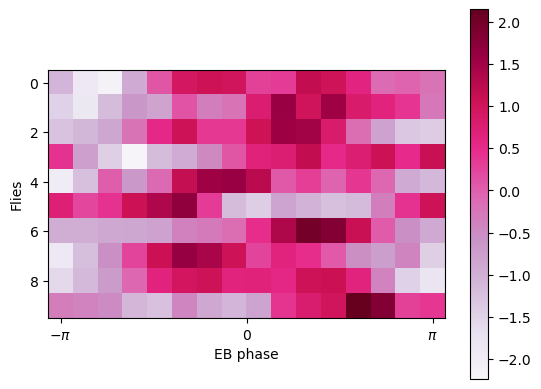

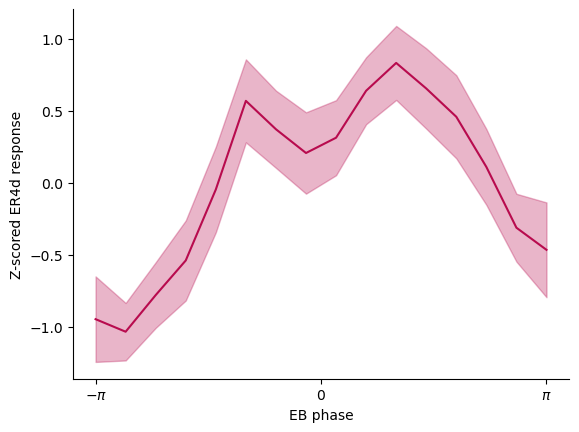

In [55]:
fig,ax = plt.subplots()
# ax.imshow(r4d_all, cmap = 'PuRd')


mask = offset_all==180

h=ax.imshow(r4d_all_shift_z[mask,:],cmap='PuRd')
ax.set_xlabel('EB phase')
ax.set_xticks([0, 7.5, 15], labels=[r'$-\pi$', r'0', r'$\pi$'])
ax.set_ylabel('Flies')
fig.colorbar(h)
fig.savefig(figfolder / 'R4d_aligned_heatmap.pdf')


fig, ax = plt.subplots()
mu = r4d_all_shift_z[mask,:].mean(axis=0)
sem = sp.stats.sem(r4d_all_shift_z[mask,:],axis=0)
x = np.linspace(-np.pi, np.pi, num=16)
ax.fill_between(x, mu-sem ,y2=mu+sem,alpha = .3, color=plt.cm.PuRd(.8))
ax.plot(x,mu, color=plt.cm.PuRd(.8))
ax.set_xticks([-3.14, 0, 3.14], labels=[r'$-\pi$', r'0', r'$\pi$'])
ax.set_xlabel('EB phase')
ax.set_ylabel('Z-scored ER4d response')
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)


# fig.savefig(figfolder / 'R4d_aligned_avg.pdf')

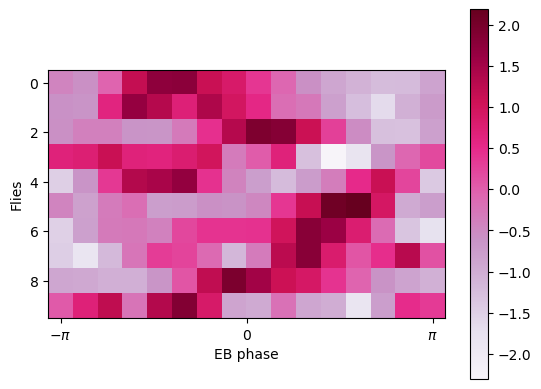

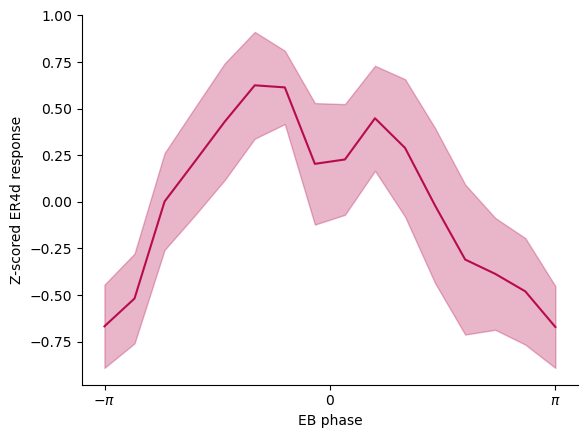

In [56]:
fig,ax = plt.subplots()
# ax.imshow(r4d_all, cmap = 'PuRd')

mask = offset_all==0

h=ax.imshow(r4d_all_shift_z[mask,:],cmap='PuRd')
ax.set_xlabel('EB phase')
ax.set_xticks([0, 7.5, 15], labels=[r'$-\pi$', r'0', r'$\pi$'])
ax.set_ylabel('Flies')
fig.colorbar(h)
fig.savefig(figfolder / 'R4d_aligned_heatmap.pdf')


fig, ax = plt.subplots()
mu = r4d_all_shift_z[mask,:].mean(axis=0)
sem = sp.stats.sem(r4d_all_shift_z[mask,:],axis=0)
x = np.linspace(-np.pi, np.pi, num=16)
ax.fill_between(x, mu-sem ,y2=mu+sem,alpha = .3, color=plt.cm.PuRd(.8))
ax.plot(x,mu, color=plt.cm.PuRd(.8))
ax.set_xticks([-3.14, 0, 3.14], labels=[r'$-\pi$', r'0', r'$\pi$'])
ax.set_xlabel('EB phase')
ax.set_ylabel('Z-scored ER4d response')
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)


fig.savefig(figfolder / 'R4d_aligned_avg.pdf')

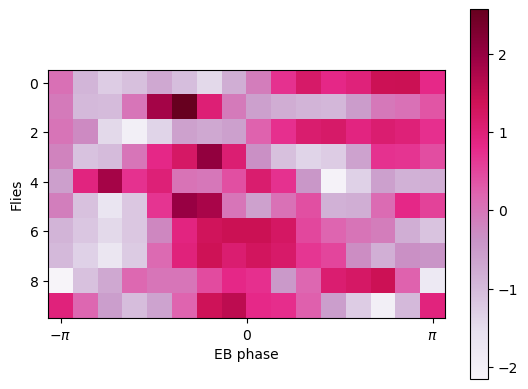

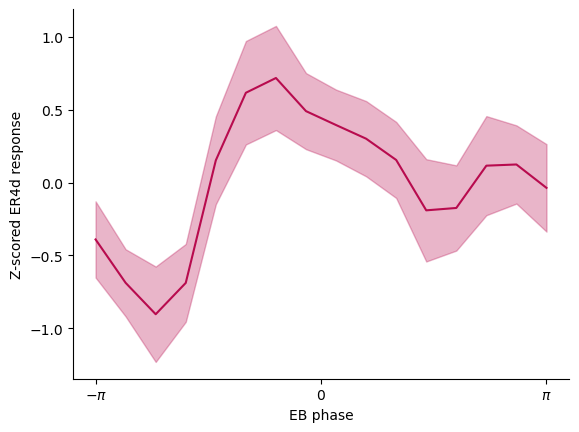

In [57]:
fig,ax = plt.subplots()
# ax.imshow(r4d_all, cmap = 'PuRd')

mask = offset_all==-1
h=ax.imshow(r4d_all_shift_z[mask,:],cmap='PuRd')
ax.set_xlabel('EB phase')
ax.set_xticks([0, 7.5, 15], labels=[r'$-\pi$', r'0', r'$\pi$'])
ax.set_ylabel('Flies')
fig.colorbar(h)
fig.savefig(figfolder / 'R4d_aligned_heatmap.pdf')


fig, ax = plt.subplots()
mu = r4d_all_shift_z[mask,:].mean(axis=0)
sem = sp.stats.sem(r4d_all_shift_z[mask,:],axis=0)
x = np.linspace(-np.pi, np.pi, num=16)
ax.fill_between(x, mu-sem ,y2=mu+sem,alpha = .3, color=plt.cm.PuRd(.8))
ax.plot(x,mu, color=plt.cm.PuRd(.8))
ax.set_xticks([-3.14, 0, 3.14], labels=[r'$-\pi$', r'0', r'$\pi$'])
ax.set_xlabel('EB phase')
ax.set_ylabel('Z-scored ER4d response')
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)


fig.savefig(figfolder / 'R4d_aligned_avg.pdf')

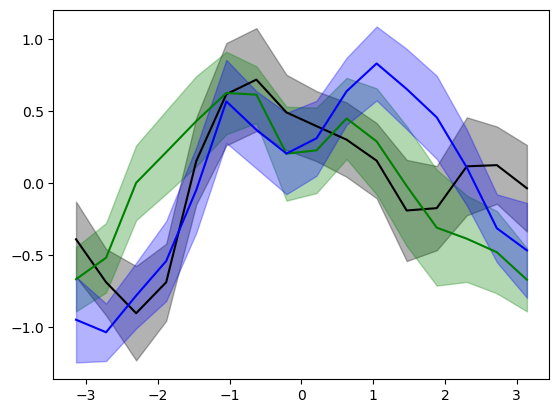

In [58]:
fig, ax= plt.subplots()

x = np.linspace(-np.pi, np.pi, num=16)

mask = offset_all==-1
mu = r4d_all_shift_z[mask,:].mean(axis=0)
sem = sp.stats.sem(r4d_all_shift_z[mask,:],axis=0)

ax.fill_between(x, mu-sem ,y2=mu+sem,alpha = .3, color='black')
ax.plot(x,mu, color='black')

mask = offset_all==0
mu = r4d_all_shift_z[mask,:].mean(axis=0)
sem = sp.stats.sem(r4d_all_shift_z[mask,:],axis=0)

ax.fill_between(x, mu-sem ,y2=mu+sem,alpha = .3, color='green')
ax.plot(x,mu, color='green')

mask = offset_all==180
mu = r4d_all_shift_z[mask,:].mean(axis=0)
sem = sp.stats.sem(r4d_all_shift_z[mask,:],axis=0)

ax.fill_between(x, mu-sem ,y2=mu+sem,alpha = .3, color='blue')
ax.plot(x,mu, color='blue')




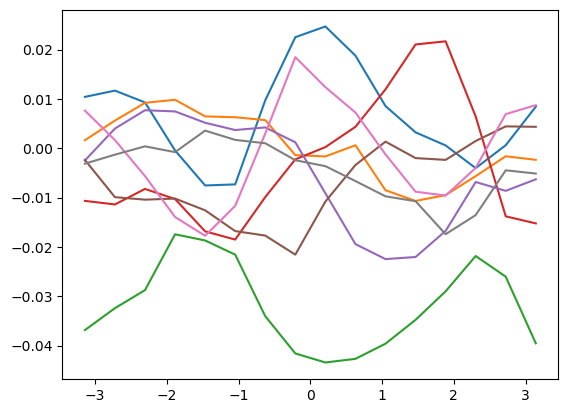

In [59]:

diff = r4d_all_shift[offset_all==0,:][-8:,:]-r4d_all_shift[offset_all==180,:][-8:,:]
# print(diff)
fig, ax = plt.subplots()
mu, sem = diff.mean(axis=0),sp.stats.sem(diff,axis=0)
x = np.linspace(-np.pi, np.pi,num=16)
ax.plot(x,diff.T)
# ax.plot(x,diff.mean(axis=0))
# ax.fill_between(x, mu-sem,mu+sem,alpha=.3)
# ax.plot(x,np.zeros_like(x),'k--',zorder=-1)

In [60]:
t,p = sp.stats.wilcoxon(diff.sum(axis=-1))
print(t,p)

8.0 0.1953125
